# Visualization of flatmaps
visual vs cortical space connective fields and psc vs z-scored + pRF data

In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import cortex
from prfpy.utils import subsurface
from scipy.io import loadmat
from scipy.ndimage import median_filter, gaussian_filter, binary_propagation
import matplotlib.animation as animation
from prfpy.stimulus import PRFStimulus2D
from prfpy.model import Iso2DGaussianModel, CSS_Iso2DGaussianModel
from prfpy.fit import Iso2DGaussianFitter, CSS_Iso2DGaussianFitter
import pandas as pd
from scipy.spatial.distance import squareform
import nibabel as nib
import numpy as np
from prfpy.stimulus import CFStimulus
from prfpy.model import CFGaussianModel
from prfpy.fit import CFFitter
import matplotlib.pyplot as plt

/tank/klundert/.local/lib/python3.7/site-packages/nilearn/datasets/__init__.py:96: FutureWarning: Fetchers from the nilearn.datasets module will be updated in version 0.9 to return python strings instead of bytes and Pandas dataframes instead of Numpy arrays.
  "Numpy arrays.", FutureWarning)
/tank/klundert/.local/lib/python3.7/site-packages/nilearn/glm/__init__.py:56: FutureWarning: The nilearn.glm module is experimental. It may change in any future release of Nilearn.
  'It may change in any future release of Nilearn.', FutureWarning)


In [16]:
def angle(x0, y0):
    return np.angle(x0 + y0 * 1j)

def ecc(x0, y0):
    return np.abs(x0 + y0 * 1j)

def splitList(array):
    n = len(array)
    half = int(n/2) # py3
    return array[:half], array[n-half:]

import h5py
idxs = h5py.File('/tank/shared/timeless/atlases/cifti_indices.hdf5', "r")
lidxs = np.array(idxs['Left_indices'])
ridxs = np.array(idxs['Right_indices'])

def get_cortex(dat):
    l, r, = dat[lidxs], dat[ridxs]

    # Replace the minus 1
    l[lidxs == -1] = np.zeros_like(l[lidxs == -1])
    r[ridxs == -1] = np.zeros_like(r[ridxs == -1])

    # Last dimension time.
    # l, r = l.T, r.T

    data = np.concatenate([l, r])
    return data

def alpha_plot(dat,dat2,vmax,subject='fsaverage',vmin=0,rois=False,colorbar=False,cmap='plasma_alpha',ax=None):
    light=cortex.Vertex2D(dat,dat2,subject=subject, vmin=vmin, vmax=vmax,vmin2=0,vmax2=np.nanmax(dat2),cmap=cmap)
    mfig=cortex.quickshow(light,with_curvature=True,with_rois=rois,with_colorbar=colorbar,fig=ax)

## SUB 2: load data and plot flatmaps

In [58]:
fold = 1
sub = 2

gauss_prf = get_cortex(np.load(f'/scratch/2021/nprf_ss/derivatives/prf-fits/sub-0{sub}/gaussian-prf/sub-0{sub}_task-prf_space-fsLR_den-170k_desc-preproc_gaussPRF_params_cv_fold{fold}.npy'))
norm_prf = get_cortex(np.load(f'/scratch/2021/nprf_ss/derivatives/prf-fits/sub-0{sub}/dn-prf/sub-0{sub}_task-prf_space-fsLR_den-170k_desc-preproc_normPRF_params_cv_fold{fold}.npy'))

CF_cort = np.load(f'/scratch/2021/nprf_ss/derivatives/cf-fits/sub-0{sub}/limit_sample_gauss/cortical_space/sub-0{sub}_task-prf_space-fsLR_den-170k_desc-preproc_gauss_CF_params_cortical_space_fold{fold}_old.npy')
CF_vis = np.load(f'/scratch/2021/nprf_ss/derivatives/cf-fits/sub-0{sub}/limit_sample_gauss/visual_space/sub-0{sub}_task-prf_space-fsLR_den-170k_desc-preproc_gauss_CF_params_visual_space_fold{fold}_old.npy')

CF_cort_zsc = np.load(f'/scratch/2021/nprf_ss/derivatives/cf-fits/sub-0{sub}/limit_sample_gauss/cortical_space/sub-0{sub}_task-prf_space-fsLR_den-170k_desc-preproc_gauss_CF_params_cortical_space_fold{fold}_zsc.npy')
CF_vis_zsc = np.load(f'/scratch/2021/nprf_ss/derivatives/cf-fits/sub-0{sub}/limit_sample_gauss/visual_space/sub-0{sub}_task-prf_space-fsLR_den-170k_desc-preproc_gauss_CF_params_visual_space_fold{fold}_zsc.npy')

gfn_ecc = ecc(gauss_prf[:,0], gauss_prf[:,1])
gfn_angle = angle(gauss_prf[:,0], gauss_prf[:,1])

d = {'ecc': gfn_ecc, 'angle': gfn_angle}
ret_frame = pd.DataFrame(data=d)
spliced_lookup_vis=ret_frame.iloc[CF_vis[:,3].astype(int),:]
spliced_lookup_cort=ret_frame.iloc[CF_cort[:,3].astype(int),:]

### Cortical space

Text(0.5, 0.98, 'CF cortical space angle sub 1')

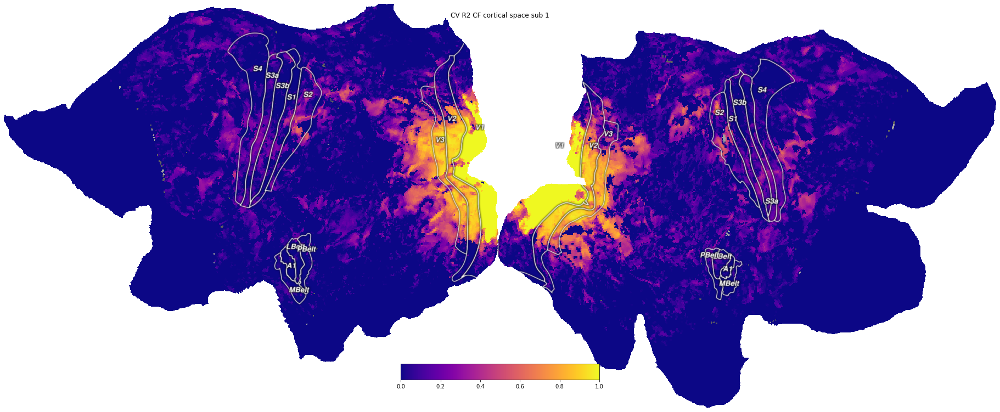

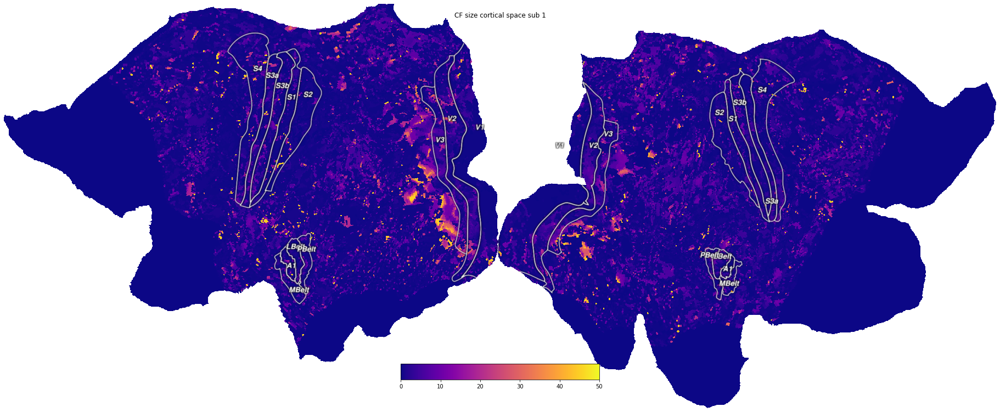

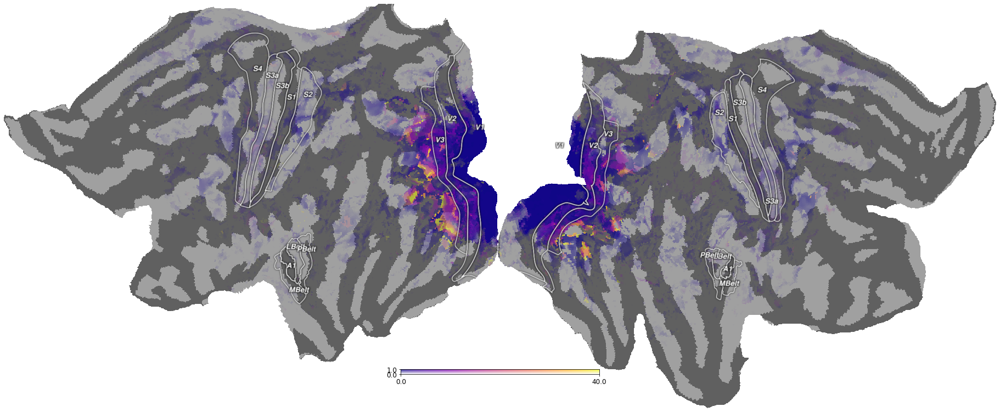

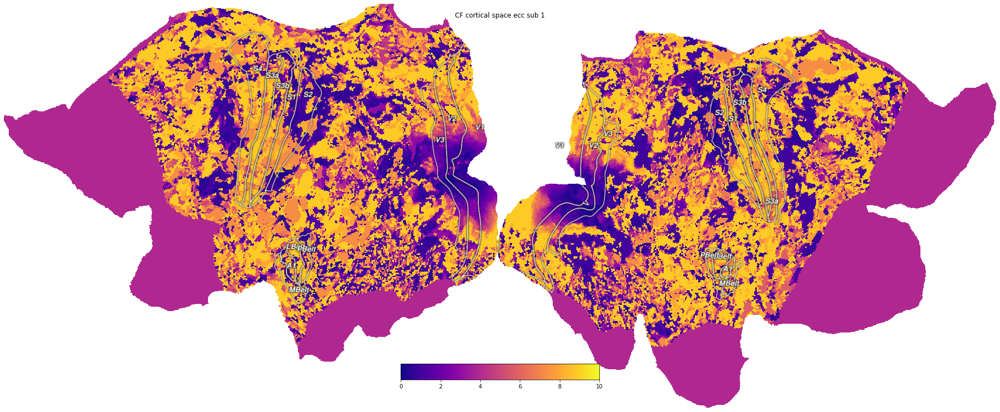

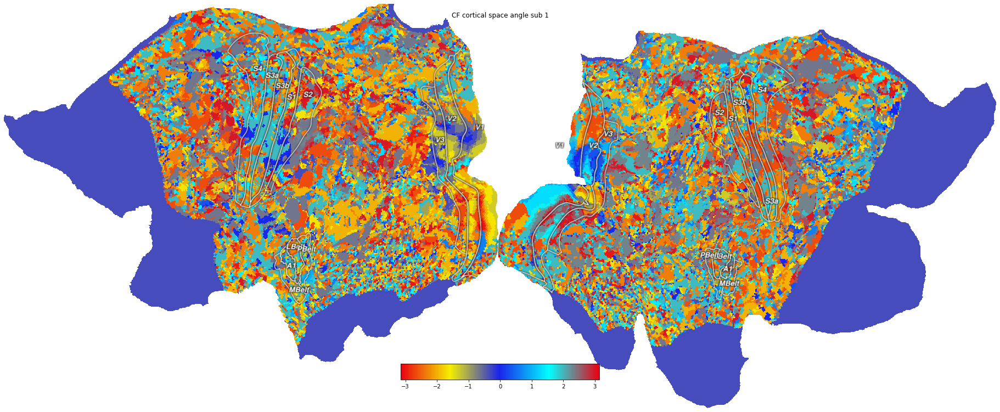

In [65]:
## cortical space
f = cortex.quickshow(cortex.Vertex(CF_cort[:,-1], subject='hcp_999999', cmap='plasma', vmin=0,vmax=1), with_curvature=True);
f.suptitle(f'CV R2 CF cortical space sub {sub}')

f = cortex.quickshow(cortex.Vertex(CF_cort[:,0], subject='hcp_999999', cmap='plasma', vmin=0,vmax=50), with_curvature=True);
f.suptitle(f'CF size cortical space sub {sub}')

alpha_plot(CF_cort[:,0],CF_cort[:,-1],vmax=40,rois=True,cmap='plasma_alpha',colorbar=True,subject='hcp_999999')

f = cortex.quickshow(cortex.Vertex(spliced_lookup_cort['ecc'].values, subject='hcp_999999', cmap='plasma',vmin=0,vmax=10), with_curvature=True);
f.suptitle(f'CF cortical space ecc sub {sub}')

f = cortex.quickshow(cortex.Vertex(spliced_lookup_cort['angle'].values, subject='hcp_999999', cmap='Retinotopy_RYBCR', vmin=-np.pi,vmax=np.pi), with_curvature=True);
f.suptitle(f'CF cortical space angle sub {sub}')

### Visual space

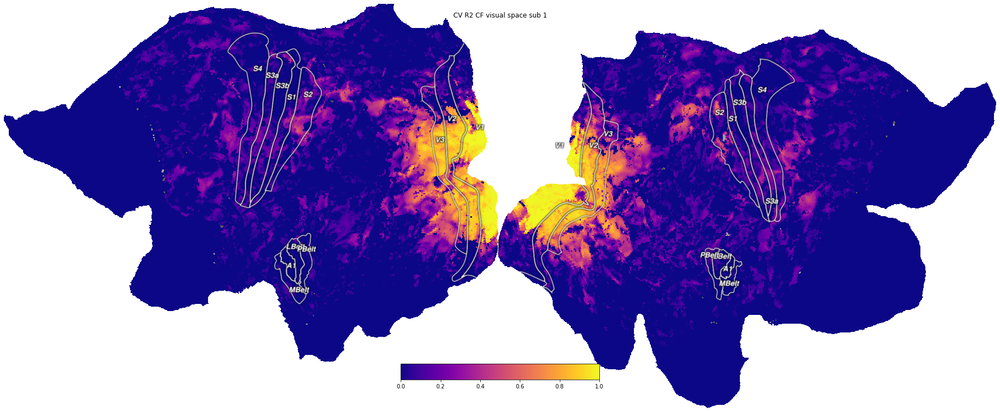

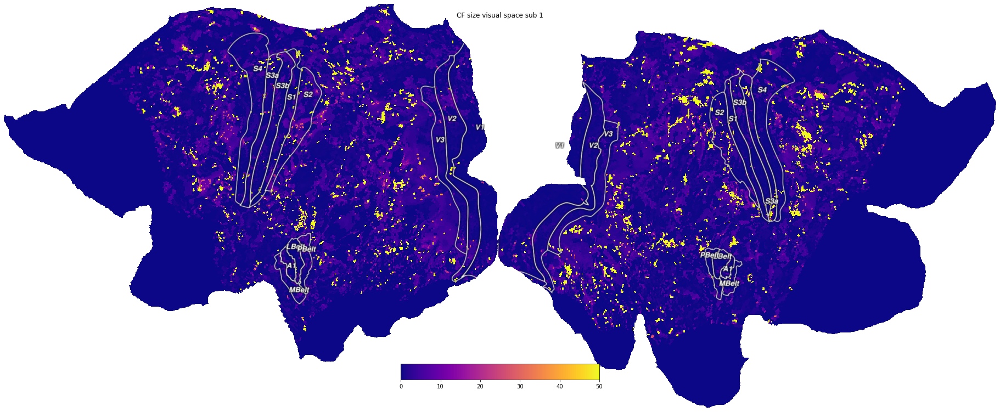

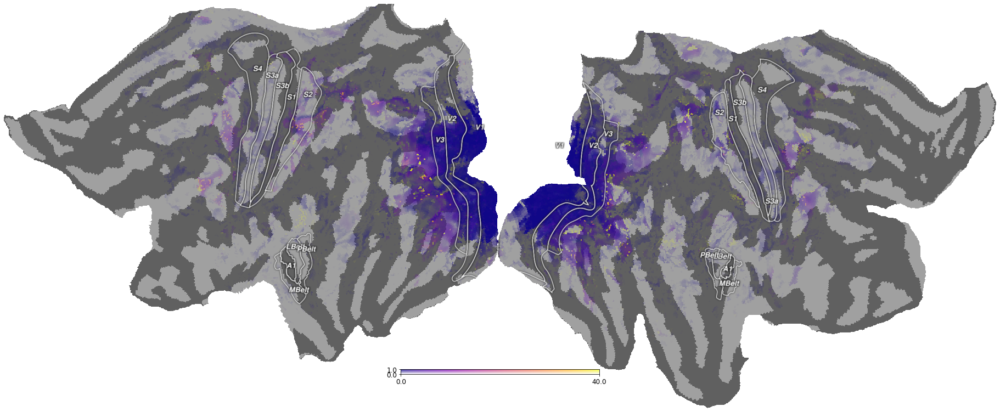

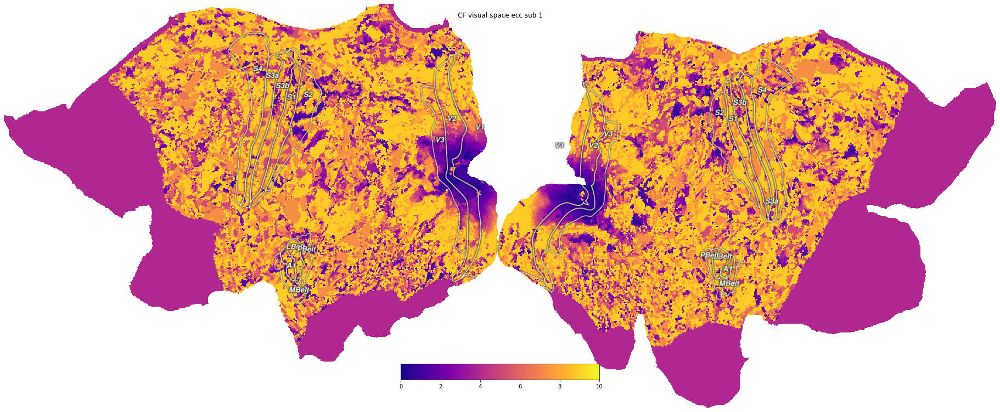

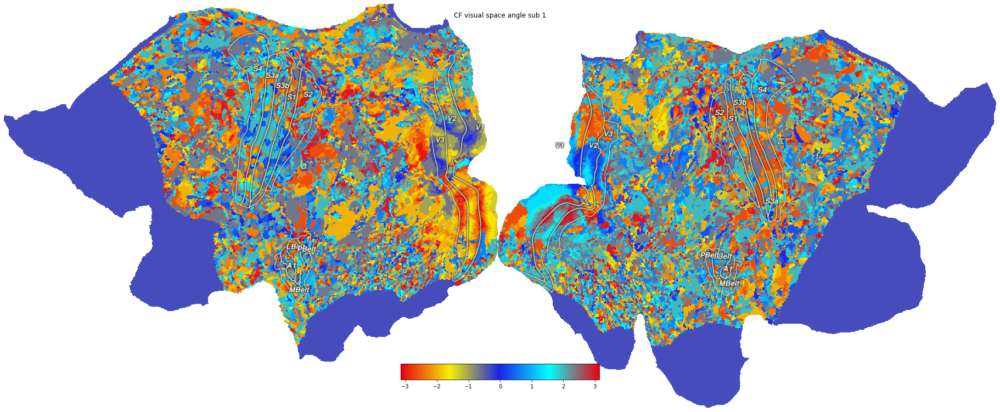

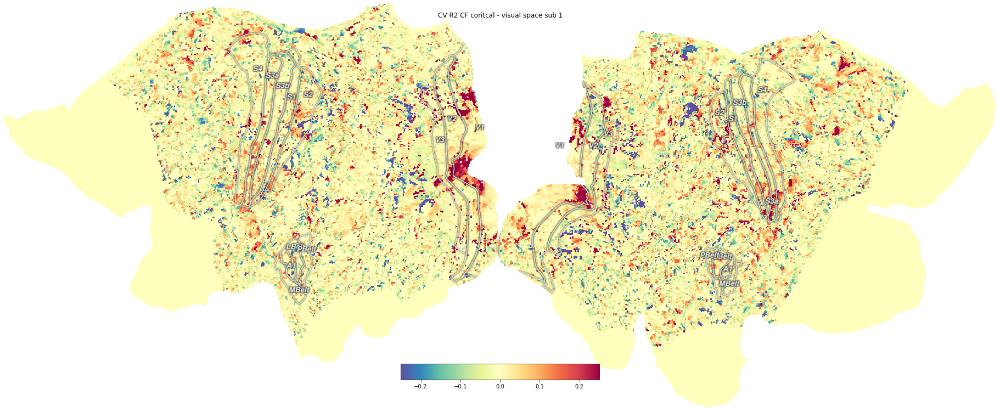

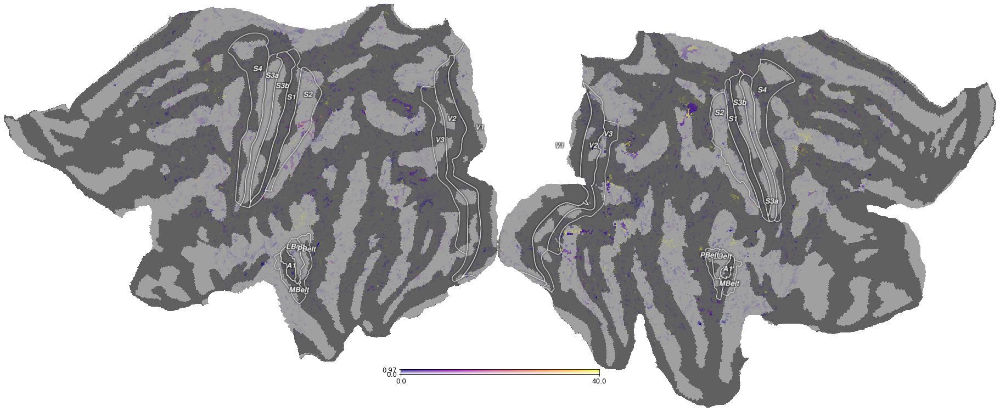

In [66]:
## visual space
f = cortex.quickshow(cortex.Vertex(CF_vis[:,-1], subject='hcp_999999', cmap='plasma',vmin=0,vmax=1), with_curvature=True);
f.suptitle(f'CV R2 CF visual space sub {sub}')

f = cortex.quickshow(cortex.Vertex(CF_vis[:,0], subject='hcp_999999', cmap='plasma', vmin=0,vmax=50), with_curvature=True);
f.suptitle(f'CF size visual space sub {sub}')

alpha_plot(CF_vis[:,0],CF_vis[:,-1],vmax=40,rois=True,cmap='plasma_alpha',colorbar=True,subject='hcp_999999')

f = cortex.quickshow(cortex.Vertex(spliced_lookup_vis['ecc'].values, subject='hcp_999999', cmap='plasma',vmin=0,vmax=10), with_curvature=True);
f.suptitle(f'CF visual space ecc sub {sub}')

f = cortex.quickshow(cortex.Vertex(spliced_lookup_vis['angle'].values, subject='hcp_999999', cmap='Retinotopy_RYBCR', vmin=-np.pi,vmax=np.pi), with_curvature=True);
f.suptitle(f'CF visual space angle sub {sub}')

## difference in R2
f = cortex.quickshow(cortex.Vertex(CF_cort[:,-1]-CF_vis[:,-1], subject='hcp_999999', cmap='Spectral_r', vmin=-0.25, vmax=0.25), with_curvature=True);
f.suptitle(f'CV R2 CF coritcal - visual space sub {sub}')

vis_imp = CF_vis[:,-1] - CF_cort[:,-1]
alpha_plot(CF_vis[:,0],vis_imp,vmax=40,rois=True,cmap='plasma_alpha',colorbar=True,subject='hcp_999999')


### psc vs z-scored


Text(0.5, 0.98, 'CV R2 difference psc-zsc visual space 2 2')

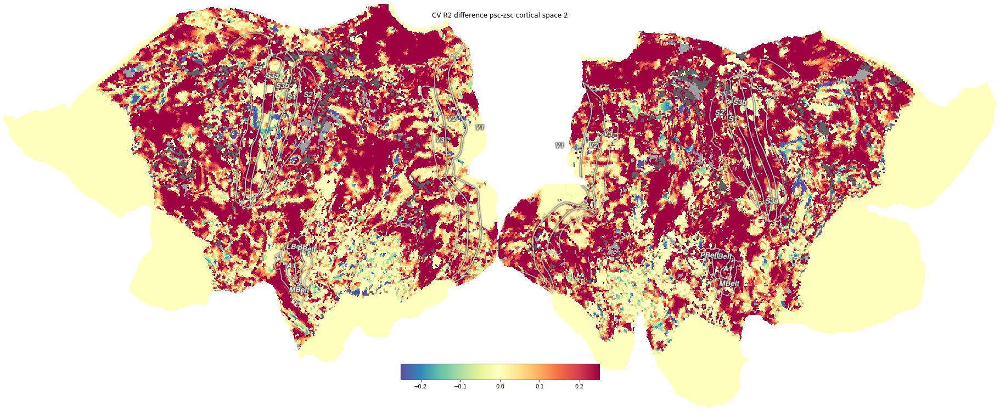

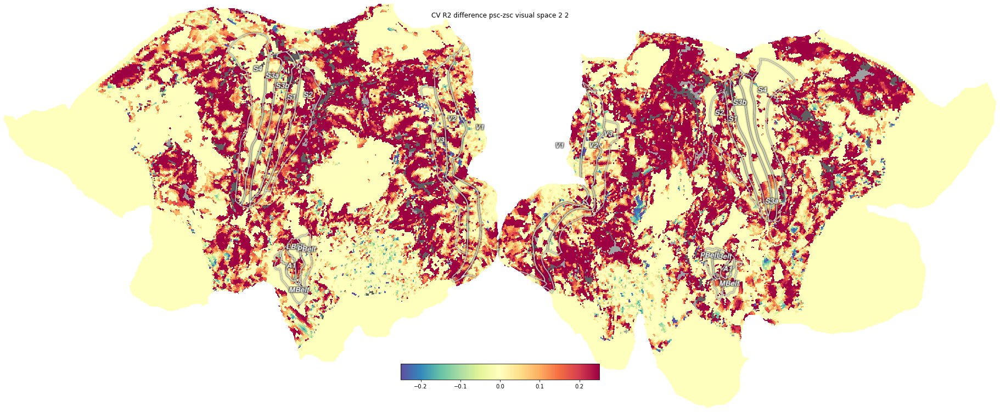

In [59]:
## psc vs z-scored

f = cortex.quickshow(cortex.Vertex(CF_cort[:,-1]-CF_cort_zsc[:,-1], subject='hcp_999999', cmap='Spectral_r', vmin=-0.25, vmax=0.25), with_curvature=True);
f.suptitle(f'CV R2 difference psc-zsc cortical space {sub}')

f = cortex.quickshow(cortex.Vertex(CF_vis[:,-1]-CF_vis_zsc[:,-1], subject='hcp_999999', cmap='Spectral_r', vmin=-0.25, vmax=0.25), with_curvature=True);
f.suptitle(f'CV R2 difference psc-zsc visual space {sub}')

### prf fits and R2 difference between norm and gauss and CF and pRF

Text(0.5, 0.98, 'CV R2 gauss CF (cortical) - norm pRF sub 2')

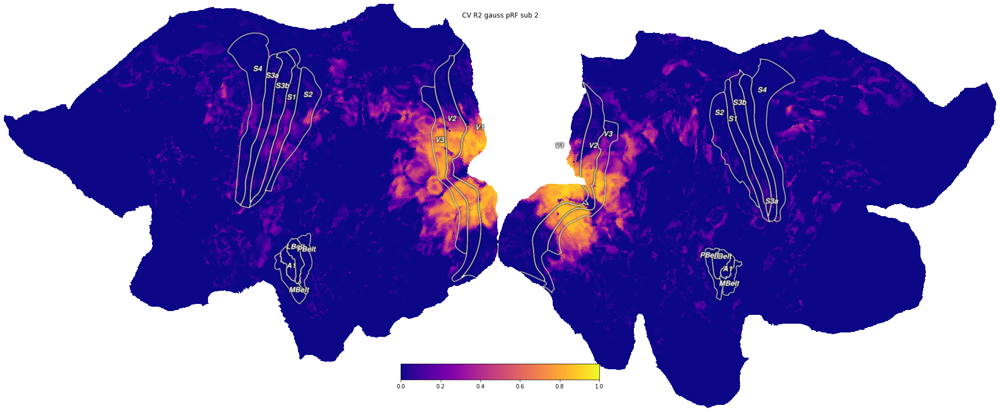

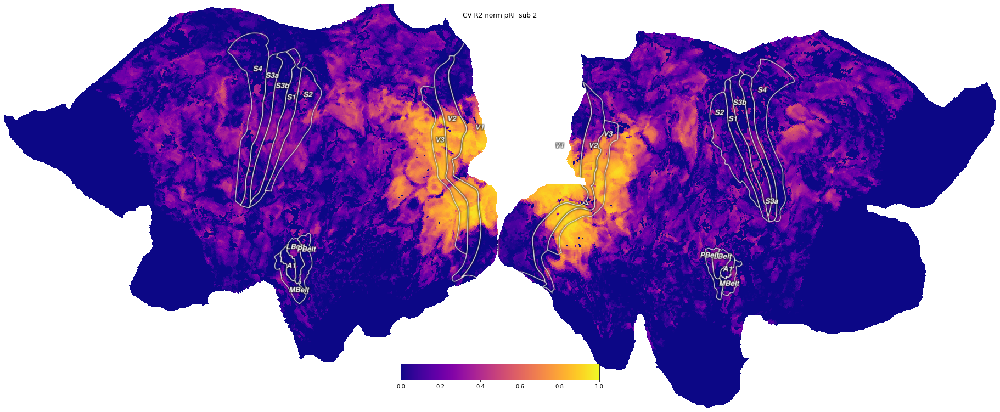

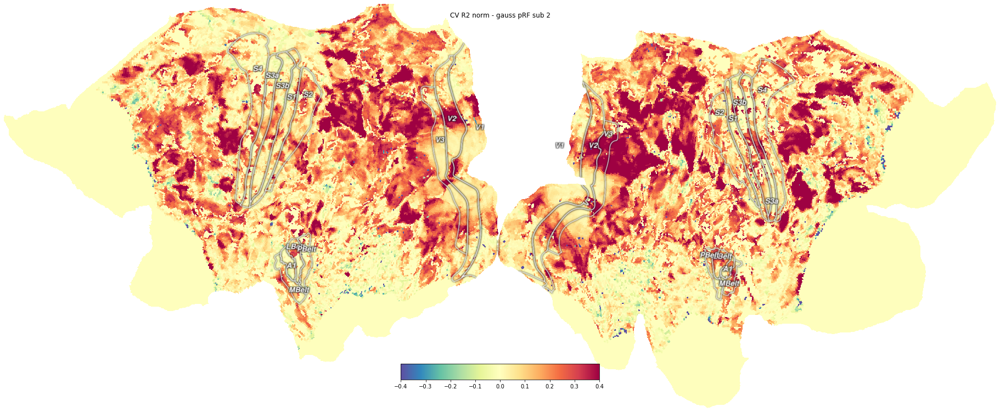

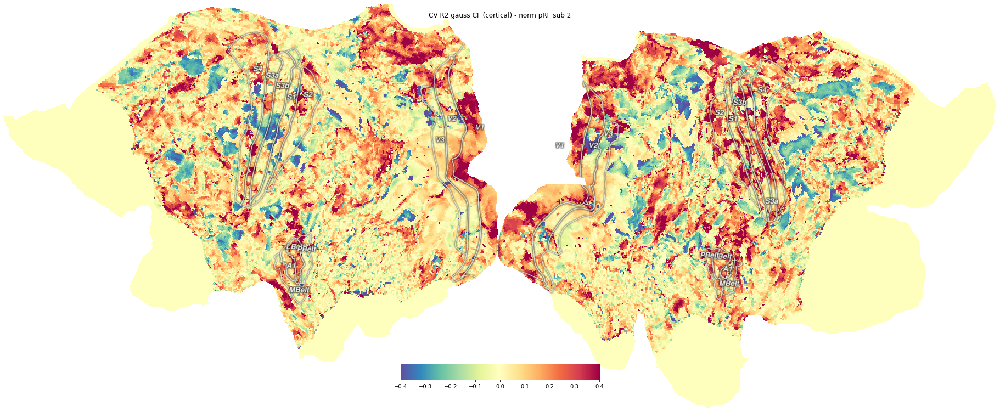

In [60]:
## prf fits and R2 difference between norm and gauss and CF and pRF

f = cortex.quickshow(cortex.Vertex(gauss_prf[:,-1], subject='hcp_999999', cmap='plasma', vmin=0, vmax=1), with_curvature=True);
f.suptitle(f'CV R2 gauss pRF sub {sub}')

f = cortex.quickshow(cortex.Vertex(norm_prf[:,-1], subject='hcp_999999', cmap='plasma', vmin=0, vmax=1), with_curvature=True);
f.suptitle(f'CV R2 norm pRF sub {sub}')

f = cortex.quickshow(cortex.Vertex(norm_prf[:,-1]-gauss_prf[:,-1], subject='hcp_999999', cmap='Spectral_r', vmin=-0.4, vmax=0.4), with_curvature=True);
f.suptitle(f'CV R2 norm - gauss pRF sub {sub}')

f = cortex.quickshow(cortex.Vertex(CF_cort[:,-1]-norm_prf[:,-1], subject='hcp_999999', cmap='Spectral_r', vmin=-0.4, vmax=0.4), with_curvature=True);
f.suptitle(f'CV R2 gauss CF (cortical) - norm pRF sub {sub}')

## SUB1:

In [61]:
fold = 1
sub = 1

gauss_prf = get_cortex(np.load(f'/scratch/2021/nprf_ss/derivatives/prf-fits/sub-0{sub}/gaussian-prf/sub-0{sub}_task-prf_space-fsLR_den-170k_desc-preproc_gaussPRF_params_cv_fold{fold}.npy'))
norm_prf = get_cortex(np.load(f'/scratch/2021/nprf_ss/derivatives/prf-fits/sub-0{sub}/dn-prf/sub-0{sub}_task-prf_space-fsLR_den-170k_desc-preproc_normPRF_params_cv_fold{fold}.npy'))

CF_cort = np.load(f'/scratch/2021/nprf_ss/derivatives/cf-fits/sub-0{sub}/limit_sample_gauss/cortical_space/sub-0{sub}_task-prf_space-fsLR_den-170k_desc-preproc_gauss_CF_params_cortical_space_fold{fold}.npy')
CF_vis = np.load(f'/scratch/2021/nprf_ss/derivatives/cf-fits/sub-0{sub}/limit_sample_gauss/visual_space/sub-0{sub}_task-prf_space-fsLR_den-170k_desc-preproc_gauss_CF_params_visual_space_fold{fold}.npy')

CF_cort_zsc = np.load(f'/scratch/2021/nprf_ss/derivatives/cf-fits/sub-0{sub}/limit_sample_gauss/cortical_space/sub-0{sub}_task-prf_space-fsLR_den-170k_desc-preproc_gauss_CF_params_cortical_space_fold{fold}_zsc.npy')
CF_vis_zsc = np.load(f'/scratch/2021/nprf_ss/derivatives/cf-fits/sub-0{sub}/limit_sample_gauss/visual_space/sub-0{sub}_task-prf_space-fsLR_den-170k_desc-preproc_gauss_CF_params_visual_space_fold{fold}_zsc.npy')


gfn_ecc = ecc(gauss_prf[:,0], gauss_prf[:,1])
gfn_angle = angle(gauss_prf[:,0], gauss_prf[:,1])

d = {'ecc': gfn_ecc, 'angle': gfn_angle}
ret_frame = pd.DataFrame(data=d)
spliced_lookup_vis=ret_frame.iloc[CF_vis[:,3].astype(int),:]
spliced_lookup_cort=ret_frame.iloc[CF_cort[:,3].astype(int),:]

### Cortical space

Text(0.5, 0.98, 'CF cortical space angle sub 1')

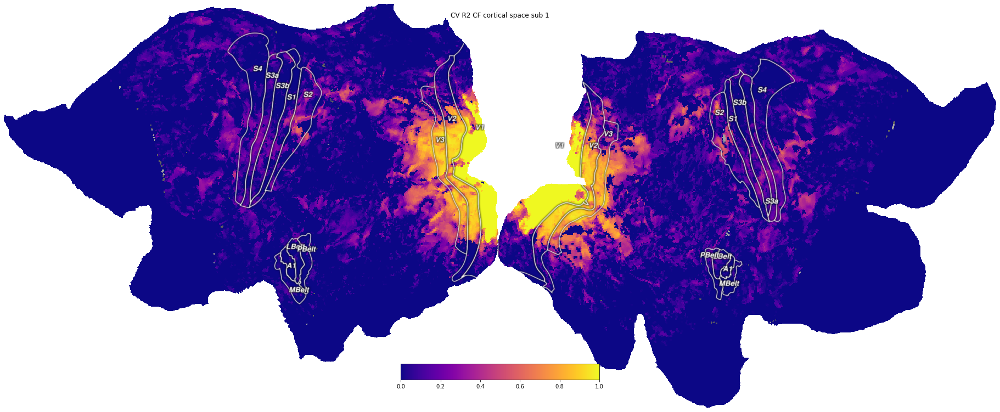

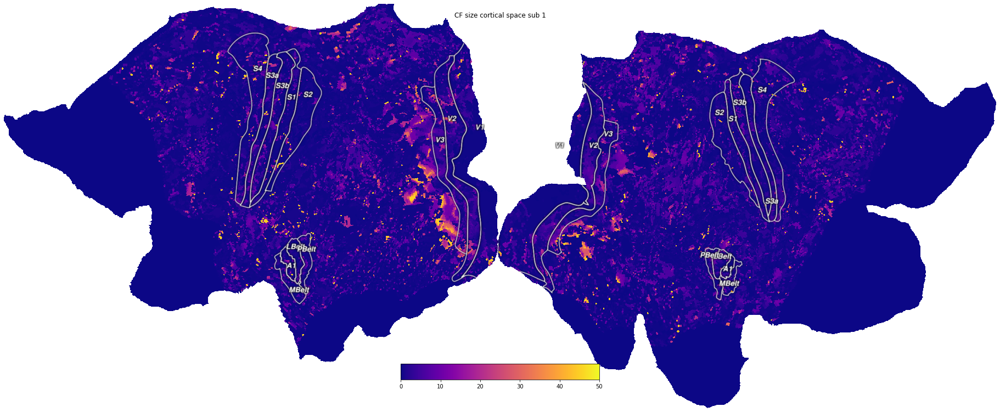

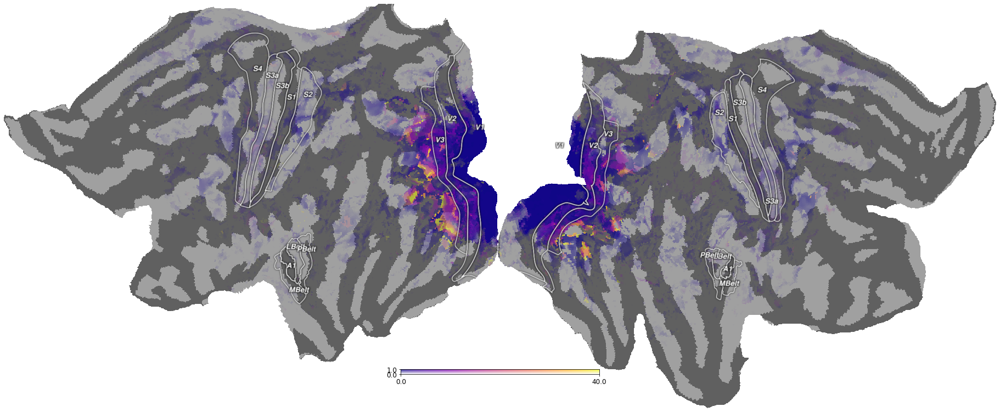

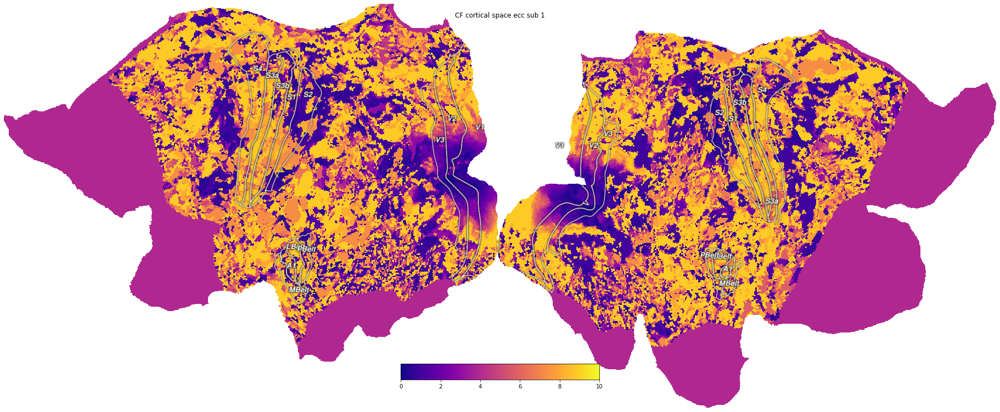

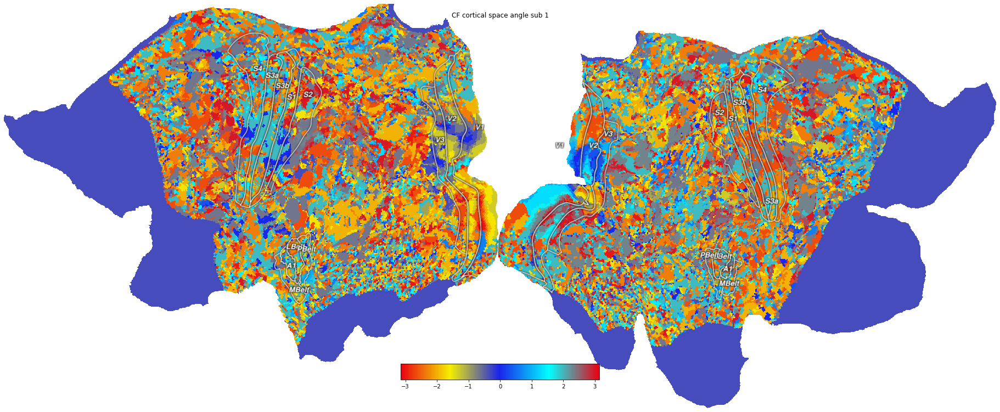

In [67]:
## cortical space
f = cortex.quickshow(cortex.Vertex(CF_cort[:,-1], subject='hcp_999999', cmap='plasma', vmin=0,vmax=1), with_curvature=True);
f.suptitle(f'CV R2 CF cortical space sub {sub}')

f = cortex.quickshow(cortex.Vertex(CF_cort[:,0], subject='hcp_999999', cmap='plasma', vmin=0,vmax=50), with_curvature=True);
f.suptitle(f'CF size cortical space sub {sub}')

alpha_plot(CF_cort[:,0],CF_cort[:,-1],vmax=40,rois=True,cmap='plasma_alpha',colorbar=True,subject='hcp_999999')

f = cortex.quickshow(cortex.Vertex(spliced_lookup_cort['ecc'].values, subject='hcp_999999', cmap='plasma',vmin=0,vmax=10), with_curvature=True);
f.suptitle(f'CF cortical space ecc sub {sub}')

f = cortex.quickshow(cortex.Vertex(spliced_lookup_cort['angle'].values, subject='hcp_999999', cmap='Retinotopy_RYBCR', vmin=-np.pi,vmax=np.pi), with_curvature=True);
f.suptitle(f'CF cortical space angle sub {sub}')


### Visual space

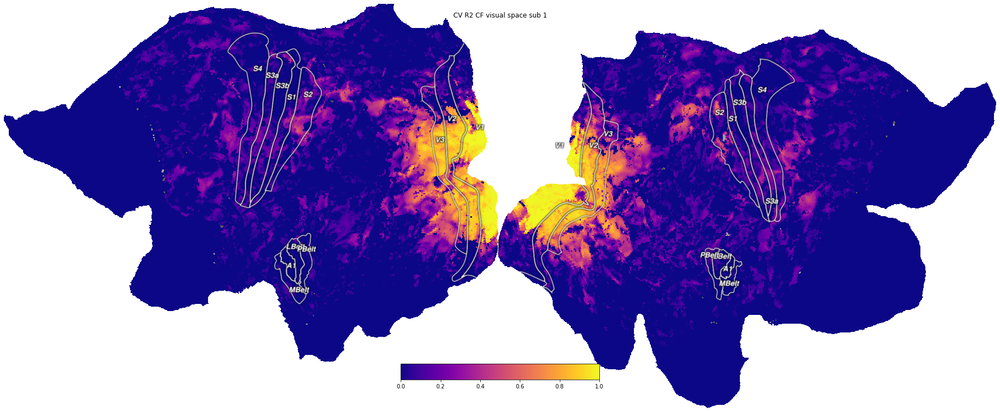

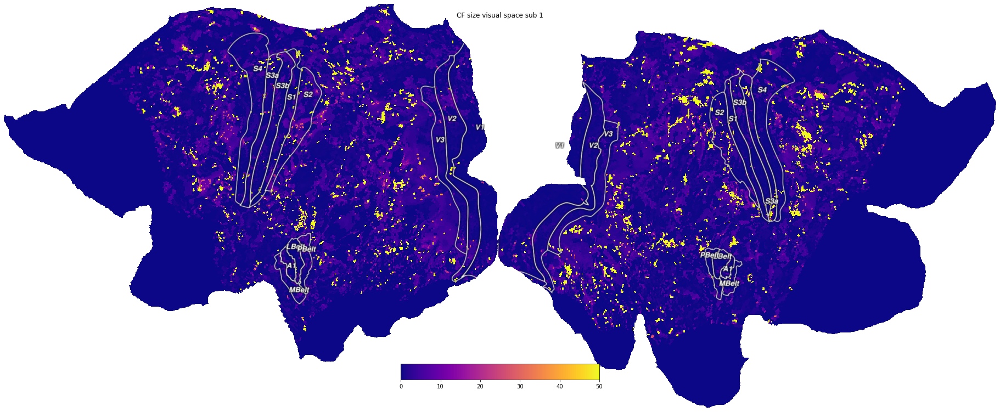

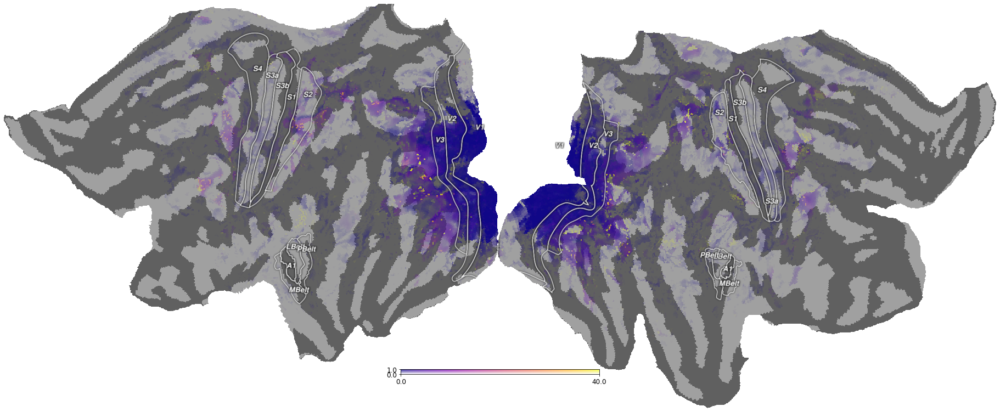

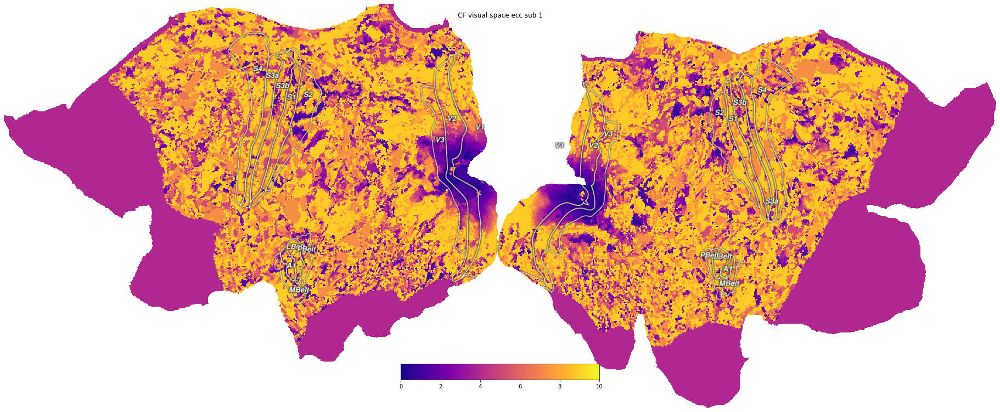

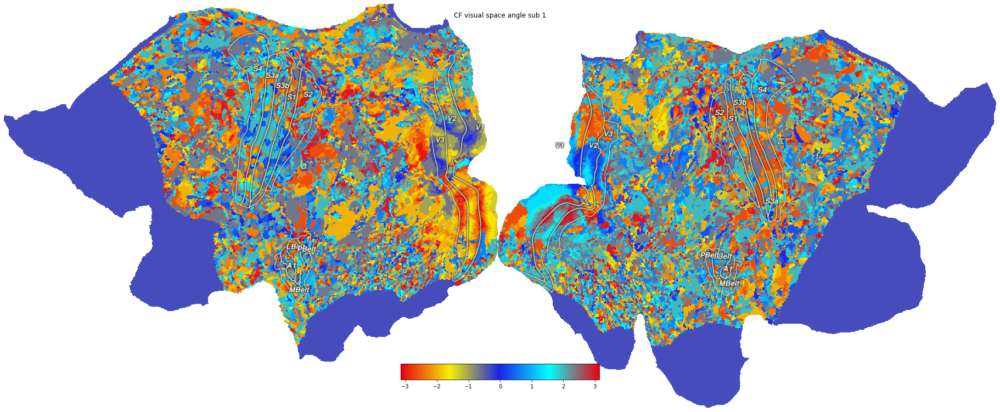

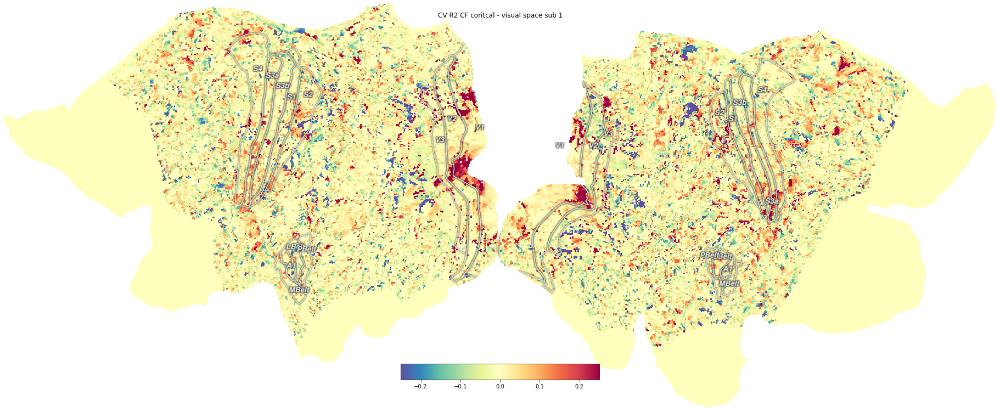

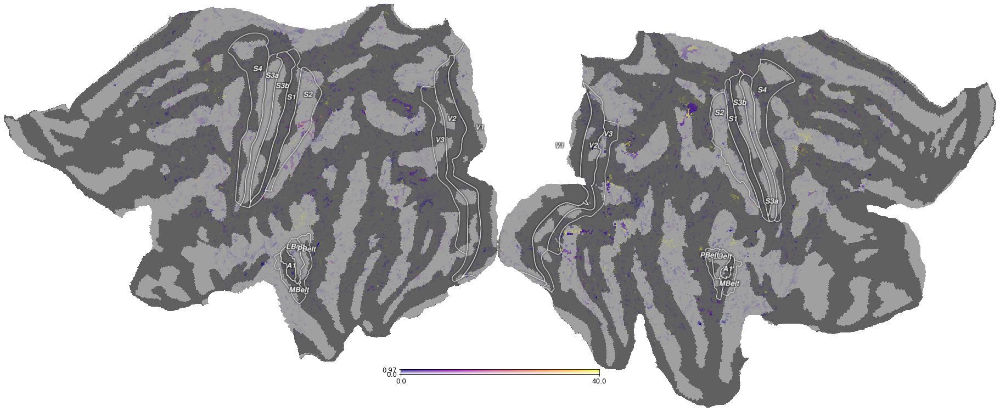

In [68]:
## visual space
f = cortex.quickshow(cortex.Vertex(CF_vis[:,-1], subject='hcp_999999', cmap='plasma',vmin=0,vmax=1), with_curvature=True);
f.suptitle(f'CV R2 CF visual space sub {sub}')

f = cortex.quickshow(cortex.Vertex(CF_vis[:,0], subject='hcp_999999', cmap='plasma', vmin=0,vmax=50), with_curvature=True);
f.suptitle(f'CF size visual space sub {sub}')

alpha_plot(CF_vis[:,0],CF_vis[:,-1],vmax=40,rois=True,cmap='plasma_alpha',colorbar=True,subject='hcp_999999')

f = cortex.quickshow(cortex.Vertex(spliced_lookup_vis['ecc'].values, subject='hcp_999999', cmap='plasma',vmin=0,vmax=10), with_curvature=True);
f.suptitle(f'CF visual space ecc sub {sub}')

f = cortex.quickshow(cortex.Vertex(spliced_lookup_vis['angle'].values, subject='hcp_999999', cmap='Retinotopy_RYBCR', vmin=-np.pi,vmax=np.pi), with_curvature=True);
f.suptitle(f'CF visual space angle sub {sub}')

## difference in R2
f = cortex.quickshow(cortex.Vertex(CF_cort[:,-1]-CF_vis[:,-1], subject='hcp_999999', cmap='Spectral_r', vmin=-0.25, vmax=0.25), with_curvature=True);
f.suptitle(f'CV R2 CF coritcal - visual space sub {sub}')

vis_imp = CF_vis[:,-1] - CF_cort[:,-1]
alpha_plot(CF_vis[:,0],vis_imp,vmax=40,rois=True,cmap='plasma_alpha',colorbar=True,subject='hcp_999999')


### psc vs z-scored

Text(0.5, 0.98, 'CV R2 difference psc-zsc visual space 1')

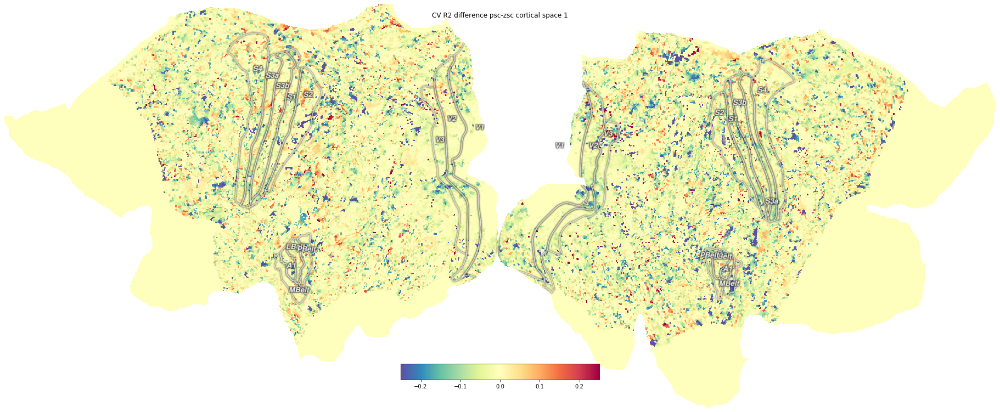

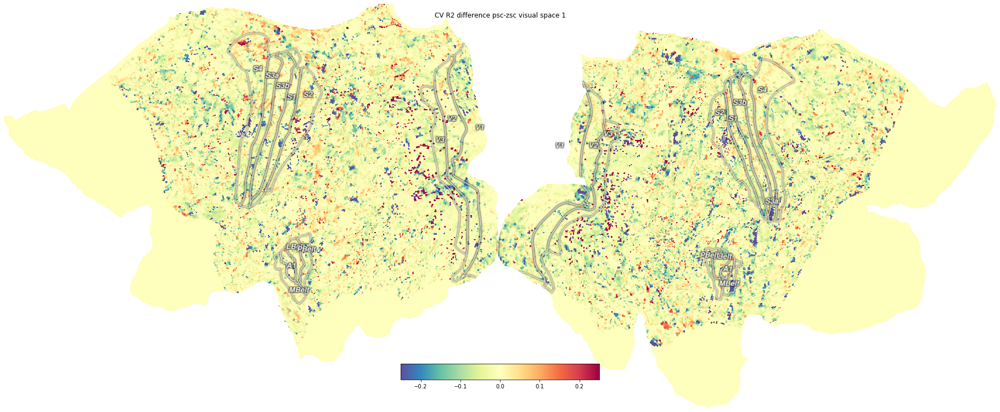

In [62]:
## psc vs z-scored
f = cortex.quickshow(cortex.Vertex(CF_cort[:,-1]-CF_cort_zsc[:,-1], subject='hcp_999999', cmap='Spectral_r', vmin=-0.25, vmax=0.25), with_curvature=True);
f.suptitle(f'CV R2 difference psc-zsc cortical space {sub}')

f = cortex.quickshow(cortex.Vertex(CF_vis[:,-1]-CF_vis_zsc[:,-1], subject='hcp_999999', cmap='Spectral_r', vmin=-0.25, vmax=0.25), with_curvature=True);
f.suptitle(f'CV R2 difference psc-zsc visual space {sub}')

### prf fits and R2 difference between norm and gauss and CF and pRF

Text(0.5, 0.98, 'CV R2 gauss CF (cortical) - norm pRF sub 1')

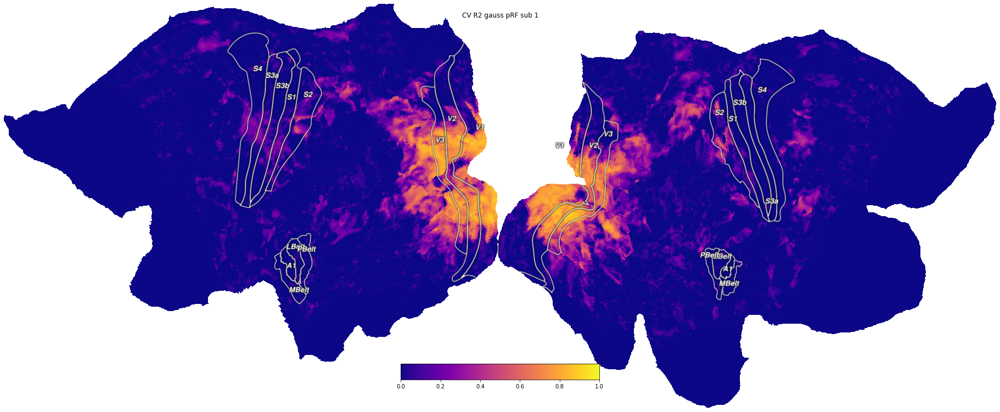

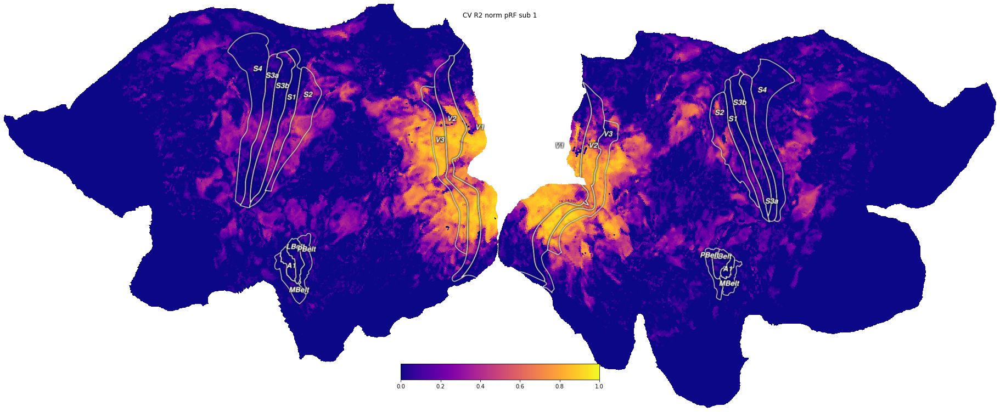

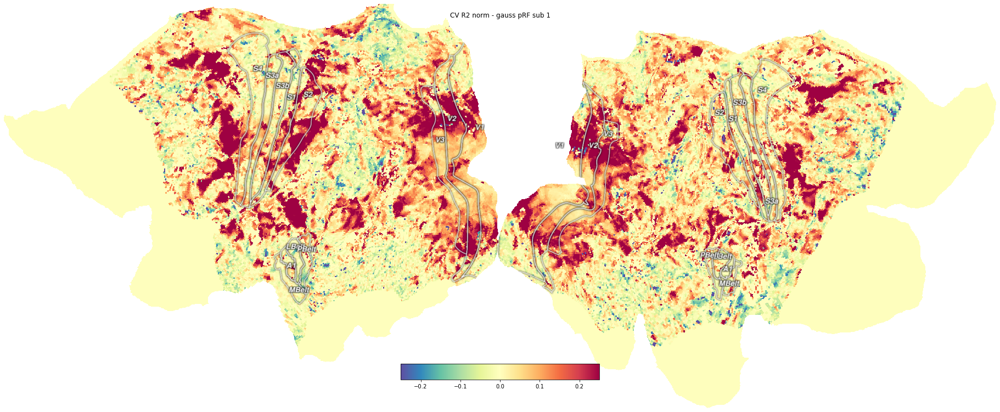

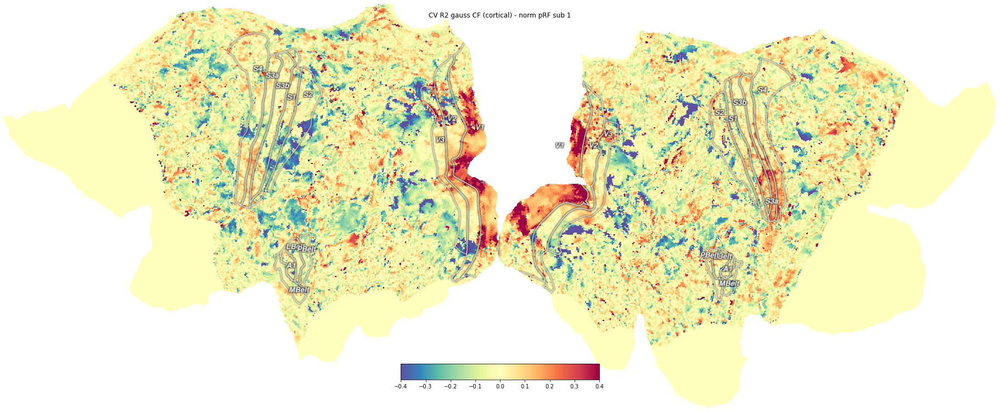

In [63]:
## prf fits and R2 difference between norm and gauss and CF and pRF

f = cortex.quickshow(cortex.Vertex(gauss_prf[:,-1], subject='hcp_999999', cmap='plasma', vmin=0,vmax=1), with_curvature=True);
f.suptitle(f'CV R2 gauss pRF sub {sub}')

f = cortex.quickshow(cortex.Vertex(norm_prf[:,-1], subject='hcp_999999', cmap='plasma', vmin=0,vmax=1), with_curvature=True);
f.suptitle(f'CV R2 norm pRF sub {sub}')

f = cortex.quickshow(cortex.Vertex(norm_prf[:,-1]-gauss_prf[:,-1], subject='hcp_999999', cmap='Spectral_r', vmin=-0.25, vmax=0.25), with_curvature=True);
f.suptitle(f'CV R2 norm - gauss pRF sub {sub}')

f = cortex.quickshow(cortex.Vertex(CF_cort[:,-1]-norm_prf[:,-1], subject='hcp_999999', cmap='Spectral_r', vmin=-0.4, vmax=0.4), with_curvature=True);
f.suptitle(f'CV R2 gauss CF (cortical) - norm pRF sub {sub}')